/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



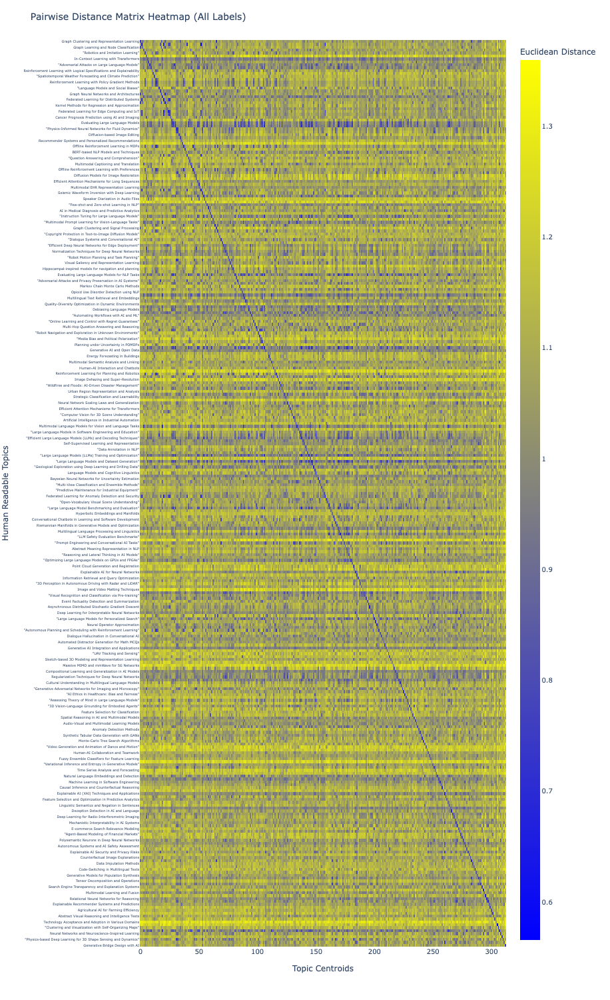

In [3]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import euclidean_distances
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('Second_step_clustering_results_labelled.csv')
bertopic_result = pd.read_csv('Second_step_clustering_BERTopic_results-Copy1.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Human_Readable_Topic in the second dataset
second_step['Human_Readable_Topic_embedding'] = second_step['Human_Readable_Topic'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Human_Readable_Topic embeddings
centroids = grouped[['Topic Label', 'centroid']]
human_readable_embeddings = second_step[['Human_Readable_Topic', 'Human_Readable_Topic_embedding']]

# Use all rows, no exclusion
centroids_limited = centroids  # No exclusion, use all rows
human_readable_embeddings_limited = human_readable_embeddings  # No exclusion, use all rows

# Initialize a matrix to store the pairwise Euclidean distances
distance_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))

# Calculate the Euclidean distance for each pair (Human Readable Topic vs. Topic Centroid)
for i, hr_embedding in enumerate(human_readable_embeddings_limited['Human_Readable_Topic_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        distance = euclidean_distances([hr_embedding], [centroid])[0][0]
        distance_matrix[i, j] = distance

# Convert the distance matrix to a DataFrame for better readability
distance_df_limited = pd.DataFrame(distance_matrix, 
                                   index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                   columns=centroids_limited['Topic Label'])

# Save the distance DataFrame to a CSV file
distance_df_limited.to_csv('first_step_pairwise_euclidean_distance_heatmap_all.csv', index=True)

# Create an interactive heatmap for the data with a blue-to-yellow color scale
fig = px.imshow(distance_df_limited,
                labels=dict(x="Topic Centroids", y="Human Readable Topics", color="Euclidean Distance"),
                x=distance_df_limited.columns,
                y=distance_df_limited.index,
                color_continuous_scale=['blue', 'yellow'],  # Custom gradient from blue to yellow
                text_auto=True)

# Adjust layout and ensure visibility
fig.update_layout(title='Pairwise Distance Matrix Heatmap (All Labels)',
                  xaxis_title='Topic Centroids',
                  yaxis_title='Human Readable Topics',
                  width=1500,
                  height=1500,
                  font=dict(size=10))  # Adjust font size here if needed

# Update y-axis layout to ensure all labels are visible
fig.update_yaxes(automargin=True,
                 tickangle=0,  # Adjust the angle of y-axis labels
                 tickfont=dict(size=5))  # Adjust the font size of y-axis labels

# Save the figure as an interactive HTML file
pio.write_html(fig, file='second_step_pairwise_euclidean_distance_heatmap_all.html', auto_open=False)

# Save the figure as a static image (e.g., PNG)
pio.write_image(fig, file='second_step_pairwise_euclidean_distance_heatmap_all.png', format='png', width=1500, height=1500, scale=3)

# Display the heatmap
fig.show()


/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



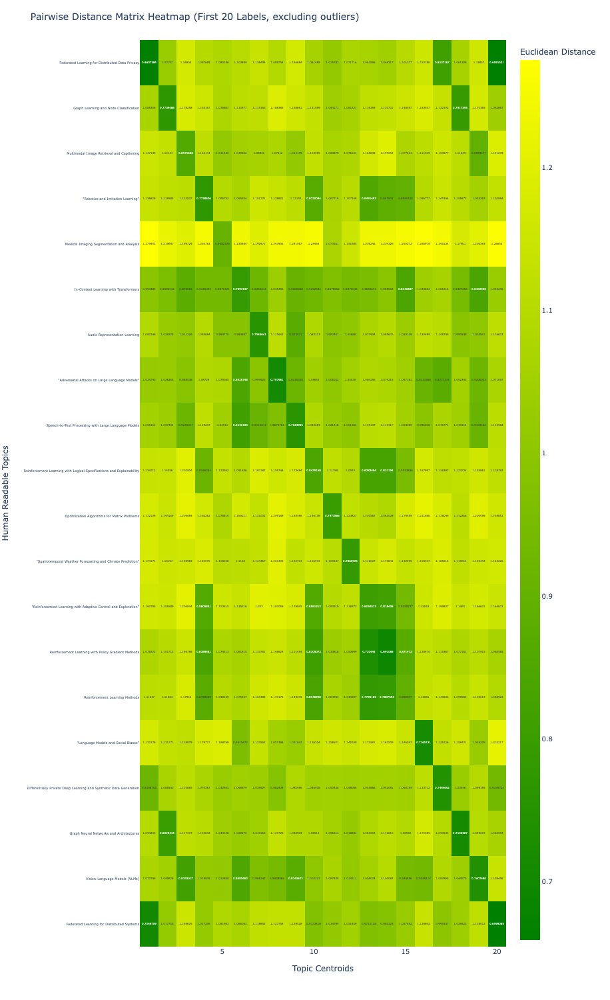

In [5]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import euclidean_distances
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('Second_step_clustering_results_labelled.csv')
bertopic_result = pd.read_csv('Second_step_clustering_BERTopic_results-Copy1.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Human_Readable_Topic in the second dataset
second_step['Human_Readable_Topic_embedding'] = second_step['Human_Readable_Topic'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Human Readable Topic embeddings
centroids = grouped[['Topic Label', 'centroid']]
human_readable_embeddings = second_step[['Human_Readable_Topic', 'Human_Readable_Topic_embedding']]

# Exclude the first row from both centroids and human readable topics (assuming they are outliers)
centroids_limited = centroids.iloc[1:21]  # Exclude first row and then select the next 20 rows
human_readable_embeddings_limited = human_readable_embeddings.iloc[1:21]  # Exclude first row and select next 20 rows

# Initialize a matrix to store the pairwise Euclidean distances
distance_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))

# Calculate the Euclidean distance for each pair (Human Readable Topic vs. Topic Centroid)
for i, hr_embedding in enumerate(human_readable_embeddings_limited['Human_Readable_Topic_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        distance = euclidean_distances([hr_embedding], [centroid])[0][0]
        distance_matrix[i, j] = distance

# Convert the distance matrix to a DataFrame for better readability
distance_df_limited = pd.DataFrame(distance_matrix, 
                                   index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                   columns=centroids_limited['Topic Label'])

# Save the limited distance DataFrame to a CSV file
distance_df_limited.to_csv('first_step_pairwise_euclidean_distance_heatmap_20.csv', index=True)

# Create an interactive heatmap for the limited data with a blue-to-yellow color scale
fig = px.imshow(distance_df_limited,
                labels=dict(x="Topic Centroids", y="Human Readable Topics", color="Euclidean Distance"),
                x=distance_df_limited.columns,
                y=distance_df_limited.index,
                color_continuous_scale=['green', 'yellow'],  # Custom gradient from green to yellow
                text_auto=True)

# Adjust layout and ensure visibility
fig.update_layout(title='Pairwise Distance Matrix Heatmap (First 20 Labels, excluding outliers)',
                  xaxis_title='Topic Centroids',
                  yaxis_title='Human Readable Topics',
                  width=1500,
                  height=1500,
                  font=dict(size=10))  # Adjust font size here if needed

# Update y-axis layout to ensure all labels are visible
fig.update_yaxes(automargin=True,
                 tickangle=0,  # Adjust the angle of y-axis labels
                 tickfont=dict(size=5))  # Adjust the font size of y-axis labels

# Save the figure as an interactive HTML file
pio.write_html(fig, file='second_step_pairwise_euclidean_distance_heatmap_20.html', auto_open=False)

# Save the figure as a static image (e.g., PNG)
pio.write_image(fig, file='second_step_pairwise_euclidean_distance_heatmap_20.png', format='png', width=1500, height=1500, scale=3)

# Display the heatmap
fig.show()


/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



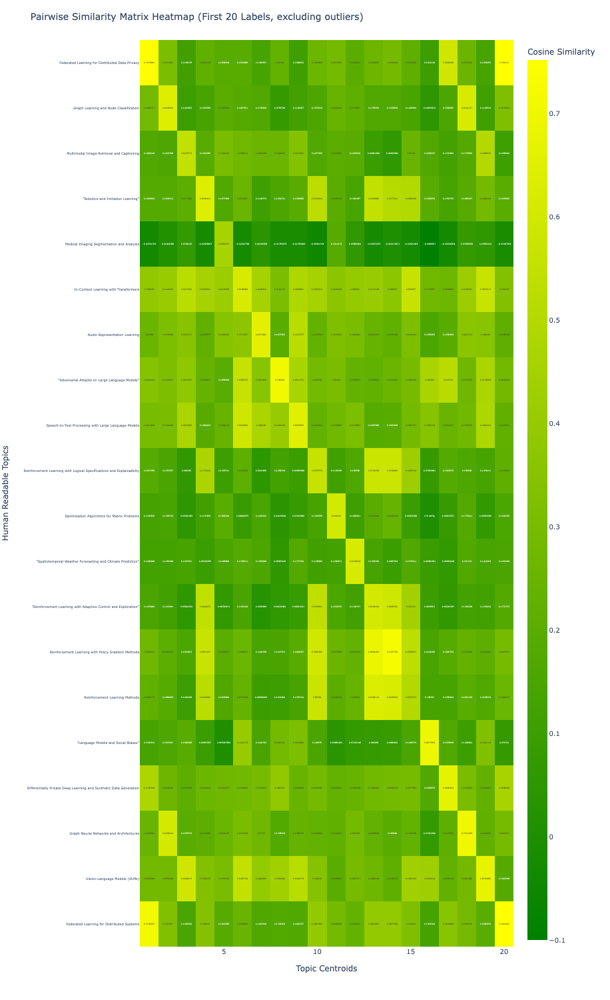

In [2]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('Second_step_clustering_results_labelled.csv')
bertopic_result = pd.read_csv('Second_step_clustering_BERTopic_results-Copy1.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Human_Readable_Topic in the second dataset
second_step['Human_Readable_Topic_embedding'] = second_step['Human_Readable_Topic'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Human Readable Topic embeddings
centroids = grouped[['Topic Label', 'centroid']]
human_readable_embeddings = second_step[['Human_Readable_Topic', 'Human_Readable_Topic_embedding']]

# Exclude the first row from both centroids and human readable topics (assuming they are outliers)
centroids_limited = centroids.iloc[1:21]  # Exclude first row and then select the next 20 rows
human_readable_embeddings_limited = human_readable_embeddings.iloc[1:21]  # Exclude first row and select next 20 rows

# Initialize a matrix to store the pairwise cosine similarities
similarity_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))

# Calculate the cosine similarity for each pair (Human Readable Topic vs. Topic Centroid)
for i, hr_embedding in enumerate(human_readable_embeddings_limited['Human_Readable_Topic_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        similarity = cosine_similarity([hr_embedding], [centroid])[0][0]
        similarity_matrix[i, j] = similarity

# Convert the similarity matrix to a DataFrame for better readability
similarity_df_limited = pd.DataFrame(similarity_matrix, 
                                     index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                     columns=centroids_limited['Topic Label'])

# Save the limited similarity DataFrame to a CSV file
similarity_df_limited.to_csv('first_step_pairwise_cosine_similarity_heatmap_20.csv', index=True)

# Create an interactive heatmap for the limited data with a blue-to-yellow color scale
fig = px.imshow(similarity_df_limited,
                labels=dict(x="Topic Centroids", y="Human Readable Topics", color="Cosine Similarity"),
                x=similarity_df_limited.columns,
                y=similarity_df_limited.index,
                color_continuous_scale=['green', 'yellow'],  # Custom gradient from blue to yellow
                text_auto=True)

# Adjust layout and ensure visibility
fig.update_layout(title='Pairwise Similarity Matrix Heatmap (First 20 Labels, excluding outliers)',
                  xaxis_title='Topic Centroids',
                  yaxis_title='Human Readable Topics',
                  width=1500,
                  height=1500,
                  font=dict(size=10))  # Adjust font size here if needed

# Update y-axis layout to ensure all labels are visible
fig.update_yaxes(automargin=True,
                 tickangle=0,  # Adjust the angle of y-axis labels
                 tickfont=dict(size=5))  # Adjust the font size of y-axis labels

# Save the figure as an interactive HTML file
pio.write_html(fig, file='second_step_pairwise_cosine_similarity_heatmap_20.html', auto_open=False)

# Save the figure as a static image (e.g., PNG)
pio.write_image(fig, file='second_step_pairwise_cosine_similarity_heatmap_20.png', format='png', width=1500, height=1500, scale=3)

# Display the heatmap
fig.show()


/home/yc656703/.local/lib/python3.9/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange
/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
/w0/tmp/slurm_yc656703.50280714/ipykernel_27960/791607069.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  human_readable_embeddings_limited['Human_Readable_Topi

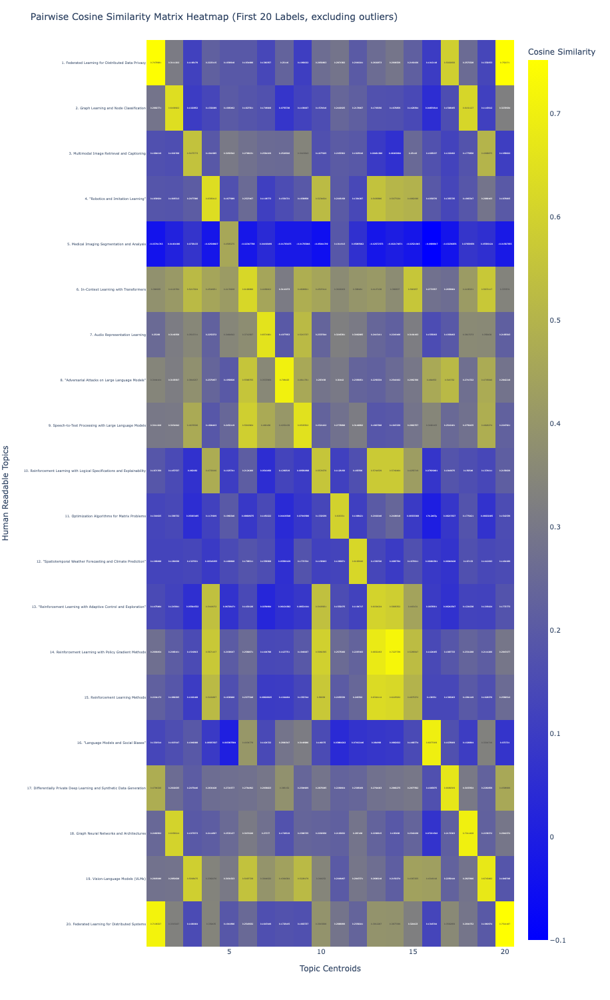

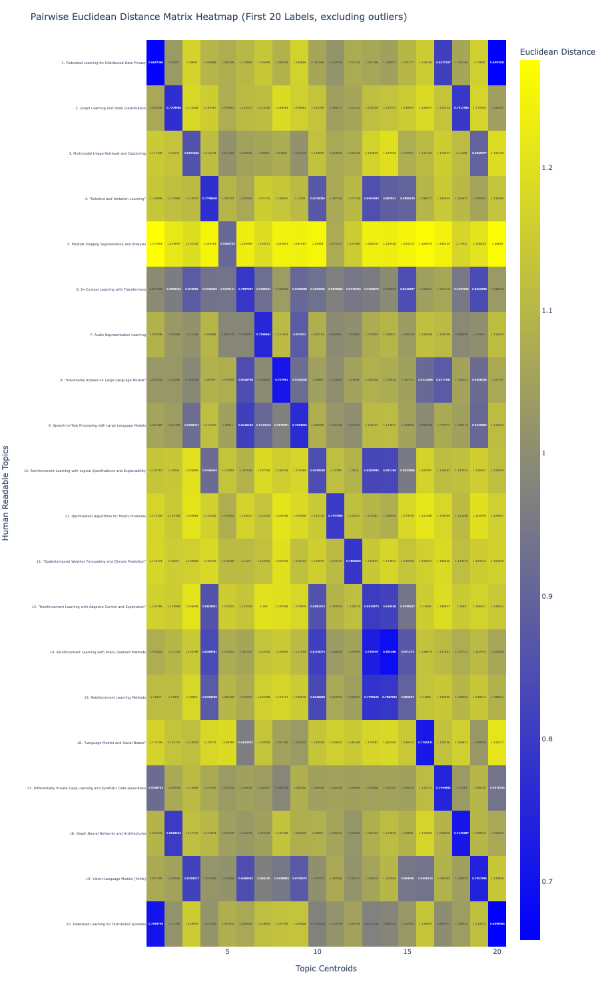

In [1]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('Second_step_clustering_results_labelled.csv')
bertopic_result = pd.read_csv('Second_step_clustering_BERTopic_results-Copy1.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Human_Readable_Topic in the second dataset
second_step['Human_Readable_Topic_embedding'] = second_step['Human_Readable_Topic'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Human_Readable_Topic embeddings
centroids = grouped[['Topic Label', 'centroid']]
human_readable_embeddings = second_step[['Human_Readable_Topic', 'Human_Readable_Topic_embedding']]

# Exclude the first row from both centroids and human readable topics (assuming they are outliers)
centroids_limited = centroids.iloc[1:21]  # Select 20 rows
human_readable_embeddings_limited = human_readable_embeddings.iloc[1:21]  # Select 20 rows

# Add numbering to the y-axis labels (Human Readable Topics)
human_readable_embeddings_limited['Human_Readable_Topic'] = [f"{i+1}. {label}" for i, label in enumerate(human_readable_embeddings_limited['Human_Readable_Topic'])]

# Initialize matrices to store the pairwise Cosine Similarities and Euclidean Distances
similarity_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))
distance_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))

# Calculate the Cosine similarity and Euclidean distance for each pair (Human Readable Topic vs. Topic Centroid)
for i, hr_embedding in enumerate(human_readable_embeddings_limited['Human_Readable_Topic_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        similarity = cosine_similarity([hr_embedding], [centroid])[0][0]
        distance = euclidean_distances([hr_embedding], [centroid])[0][0]
        similarity_matrix[i, j] = similarity
        distance_matrix[i, j] = distance

# Convert the matrices to DataFrames for better readability
similarity_df_limited = pd.DataFrame(similarity_matrix, 
                                     index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                     columns=centroids_limited['Topic Label'])

distance_df_limited = pd.DataFrame(distance_matrix, 
                                   index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                   columns=centroids_limited['Topic Label'])

# Save the DataFrames to CSV files
similarity_df_limited.to_csv('first_step_pairwise_cosine_similarity_heatmap_20.csv', index=True)
distance_df_limited.to_csv('first_step_pairwise_euclidean_distance_heatmap_20.csv', index=True)

# Create heatmaps for both similarity and distance with a blue-to-yellow color scale
def create_heatmap(df, title, color_label, filename_html, filename_png):
    fig = px.imshow(df,
                    labels=dict(x="Topic Centroids", y="Human Readable Topics", color=color_label),
                    x=df.columns,
                    y=df.index,
                    color_continuous_scale=['blue', 'yellow'],  # Custom gradient from blue to yellow
                    text_auto=True)

    # Adjust layout and ensure visibility
    fig.update_layout(title=title,
                      xaxis_title='Topic Centroids',
                      yaxis_title='Human Readable Topics',
                      width=1500,
                      height=1500,
                      font=dict(size=10))  # Adjust font size here if needed

    # Update y-axis layout to ensure all labels are visible
    fig.update_yaxes(automargin=True,
                     tickangle=0,  # Adjust the angle of y-axis labels
                     tickfont=dict(size=5))  # Adjust the font size of y-axis labels

    # Save the figure as an interactive HTML file
    pio.write_html(fig, file=filename_html, auto_open=False)

    # Save the figure as a static image (e.g., PNG)
    pio.write_image(fig, file=filename_png, format='png', width=1500, height=1500, scale=3)

    # Display the heatmap
    fig.show()

# Create and save Cosine Similarity Heatmap
create_heatmap(similarity_df_limited, 
               'Pairwise Cosine Similarity Matrix Heatmap (First 20 Labels, excluding outliers)',
               'Cosine Similarity',
               'first_step_pairwise_cosine_similarity_heatmap_20.html',
               'first_step_pairwise_cosine_similarity_heatmap_20.png')

# Create and save Euclidean Distance Heatmap
create_heatmap(distance_df_limited, 
               'Pairwise Euclidean Distance Matrix Heatmap (First 20 Labels, excluding outliers)',
               'Euclidean Distance',
               'first_step_pairwise_euclidean_distance_heatmap_20.html',
               'first_step_pairwise_euclidean_distance_heatmap_20.png')


/home/yc656703/.local/lib/python3.9/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange
/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
/w0/tmp/slurm_yc656703.50280714/ipykernel_33543/3748334118.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  human_readable_embeddings_limited['Human_Readable_Top

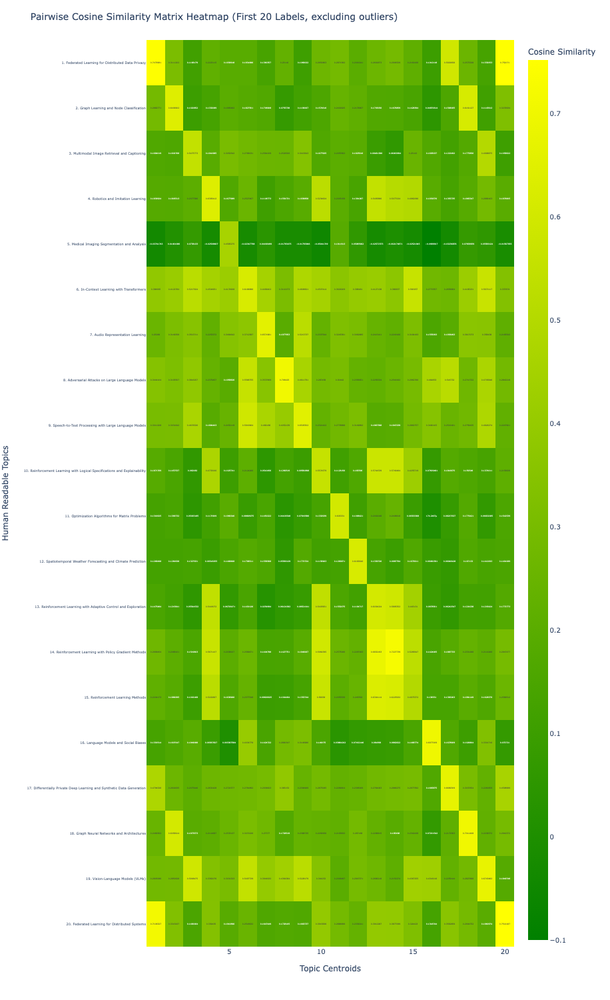

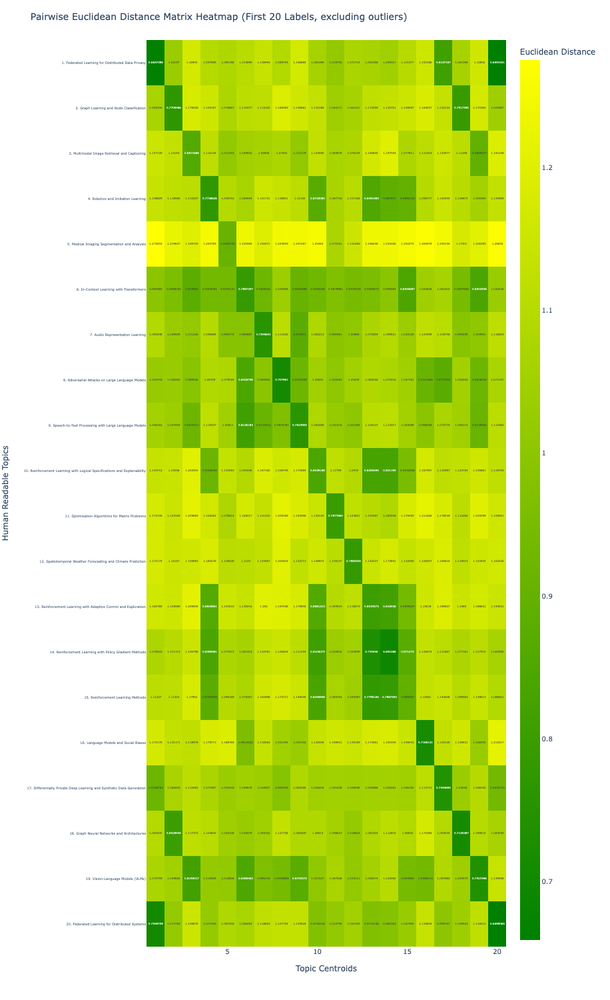

In [1]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
import plotly.express as px
import plotly.io as pio
import re

# Load the datasets
second_step = pd.read_csv('Second_step_clustering_results_labelled.csv')
bertopic_result = pd.read_csv('Second_step_clustering_BERTopic_results-Copy1.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Human_Readable_Topic in the second dataset
second_step['Human_Readable_Topic_embedding'] = second_step['Human_Readable_Topic'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Human_Readable_Topic embeddings
centroids = grouped[['Topic Label', 'centroid']]
human_readable_embeddings = second_step[['Human_Readable_Topic', 'Human_Readable_Topic_embedding']]

# Exclude the first row from both centroids and human readable topics (assuming they are outliers)
centroids_limited = centroids.iloc[1:21]  # Select 20 rows
human_readable_embeddings_limited = human_readable_embeddings.iloc[1:21]  # Select 20 rows

# Remove quotes from y-axis labels
human_readable_embeddings_limited['Human_Readable_Topic'] = human_readable_embeddings_limited['Human_Readable_Topic'].apply(lambda x: re.sub(r'[\'\"]', '', x))

# Add numbering to the y-axis labels (Human Readable Topics)
human_readable_embeddings_limited['Human_Readable_Topic'] = [f"{i+1}. {label}" for i, label in enumerate(human_readable_embeddings_limited['Human_Readable_Topic'])]

# Initialize matrices to store the pairwise Cosine Similarities and Euclidean Distances
similarity_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))
distance_matrix = np.zeros((len(human_readable_embeddings_limited), len(centroids_limited)))

# Calculate the Cosine similarity and Euclidean distance for each pair (Human Readable Topic vs. Topic Centroid)
for i, hr_embedding in enumerate(human_readable_embeddings_limited['Human_Readable_Topic_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        similarity = cosine_similarity([hr_embedding], [centroid])[0][0]
        distance = euclidean_distances([hr_embedding], [centroid])[0][0]
        similarity_matrix[i, j] = similarity
        distance_matrix[i, j] = distance

# Convert the matrices to DataFrames for better readability
similarity_df_limited = pd.DataFrame(similarity_matrix, 
                                     index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                     columns=centroids_limited['Topic Label'])

distance_df_limited = pd.DataFrame(distance_matrix, 
                                   index=human_readable_embeddings_limited['Human_Readable_Topic'], 
                                   columns=centroids_limited['Topic Label'])

# Save the DataFrames to CSV files
similarity_df_limited.to_csv('first_step_pairwise_cosine_similarity_heatmap_20.csv', index=True)
distance_df_limited.to_csv('first_step_pairwise_euclidean_distance_heatmap_20.csv', index=True)

# Create heatmaps for both similarity and distance with a blue-to-yellow color scale
def create_heatmap(df, title, color_label, filename_html, filename_png):
    fig = px.imshow(df,
                    labels=dict(x="Topic Centroids", y="Human Readable Topics", color=color_label),
                    x=df.columns,
                    y=df.index,
                    color_continuous_scale=['green', 'yellow'],  # Custom gradient from blue to yellow
                    text_auto=True)

    # Adjust layout and ensure visibility
    fig.update_layout(title=title,
                      xaxis_title='Topic Centroids',
                      yaxis_title='Human Readable Topics',
                      width=1500,
                      height=1500,
                      font=dict(size=10))  # Adjust font size here if needed

    # Update y-axis layout to ensure all labels are visible
    fig.update_yaxes(automargin=True,
                     tickangle=0,  # Adjust the angle of y-axis labels
                     tickfont=dict(size=5))  # Adjust the font size of y-axis labels

    # Save the figure as an interactive HTML file
    pio.write_html(fig, file=filename_html, auto_open=False)

    # Save the figure as a static image (e.g., PNG)
    pio.write_image(fig, file=filename_png, format='png', width=1500, height=1500, scale=3)

    # Display the heatmap
    fig.show()

# Create and save Cosine Similarity Heatmap
create_heatmap(similarity_df_limited, 
               'Pairwise Cosine Similarity Matrix Heatmap (First 20 Labels, excluding outliers)',
               'Cosine Similarity',
               'first_step_pairwise_cosine_similarity_heatmap_20.html',
               'first_step_pairwise_cosine_similarity_heatmap_20.png')

# Create and save Euclidean Distance Heatmap
create_heatmap(distance_df_limited, 
               'Pairwise Euclidean Distance Matrix Heatmap (First 20 Labels, excluding outliers)',
               'Euclidean Distance',
               'first_step_pairwise_euclidean_distance_heatmap_20.html',
               'first_step_pairwise_euclidean_distance_heatmap_20.png')


In [2]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
import plotly.express as px
import plotly.io as pio
import re

# Load the datasets
second_step = pd.read_csv('Second_step_clustering_results_labelled.csv')
bertopic_result = pd.read_csv('Second_step_clustering_BERTopic_results-Copy1.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Human_Readable_Topic in the second dataset
second_step['Human_Readable_Topic_embedding'] = second_step['Human_Readable_Topic'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Human_Readable_Topic embeddings
centroids = grouped[['Topic Label', 'centroid']]
human_readable_embeddings = second_step[['Human_Readable_Topic', 'Human_Readable_Topic_embedding']]

# Remove quotes from y-axis labels
human_readable_embeddings['Human_Readable_Topic'] = human_readable_embeddings['Human_Readable_Topic'].apply(lambda x: re.sub(r'[\'\"]', '', x))

# Add numbering to the y-axis labels (Human Readable Topics)
human_readable_embeddings['Human_Readable_Topic'] = [f"{i+1}. {label}" for i, label in enumerate(human_readable_embeddings['Human_Readable_Topic'])]

# Initialize matrices to store the pairwise Cosine Similarities and Euclidean Distances
similarity_matrix = np.zeros((len(human_readable_embeddings), len(centroids)))
distance_matrix = np.zeros((len(human_readable_embeddings), len(centroids)))

# Calculate the Cosine similarity and Euclidean distance for each pair (Human Readable Topic vs. Topic Centroid)
for i, hr_embedding in enumerate(human_readable_embeddings['Human_Readable_Topic_embedding']):
    for j, centroid in enumerate(centroids['centroid']):
        similarity = cosine_similarity([hr_embedding], [centroid])[0][0]
        distance = euclidean_distances([hr_embedding], [centroid])[0][0]
        similarity_matrix[i, j] = similarity
        distance_matrix[i, j] = distance

# Convert the matrices to DataFrames for better readability
similarity_df = pd.DataFrame(similarity_matrix, 
                             index=human_readable_embeddings['Human_Readable_Topic'], 
                             columns=centroids['Topic Label'])

distance_df = pd.DataFrame(distance_matrix, 
                           index=human_readable_embeddings['Human_Readable_Topic'], 
                           columns=centroids['Topic Label'])

# Save the DataFrames to CSV files
similarity_df.to_csv('second_step_pairwise_cosine_similarity_heatmap_all.csv', index=True)
distance_df.to_csv('second_step_pairwise_euclidean_distance_heatmap_all.csv', index=True)

# Create heatmaps for both similarity and distance with a green-to-yellow color scale
def create_heatmap(df, title, color_label, filename_html, filename_png):
    fig = px.imshow(df,
                    labels=dict(x="Topic Centroids", y="Human Readable Topics", color=color_label),
                    x=df.columns,
                    y=df.index,
                    color_continuous_scale=['green', 'yellow'],  # Custom gradient from green to yellow
                    text_auto=True)

    # Adjust layout and ensure visibility for a larger number of labels
    fig.update_layout(title=title,
                      xaxis_title='Topic Centroids',
                      yaxis_title='Human Readable Topics',
                      width=3000,  # Increase width to accommodate all topics
                      height=3000,  # Increase height to accommodate all topics
                      font=dict(size=8))  # Adjust font size here if needed

    # Update y-axis layout to ensure all labels are visible
    fig.update_yaxes(automargin=True,
                     tickangle=0,  # Adjust the angle of y-axis labels
                     tickfont=dict(size=3))  # Reduce the font size to fit a larger number of labels

    # Save the figure as an interactive HTML file
    pio.write_html(fig, file=filename_html, auto_open=False)

    # Save the figure as a static image (e.g., PNG)
    pio.write_image(fig, file=filename_png, format='png', width=3000, height=3000, scale=3)

    # Display the heatmap
    fig.show()

# Create and save Cosine Similarity Heatmap
create_heatmap(similarity_df, 
               'Pairwise Cosine Similarity Matrix Heatmap (All Labels)',
               'Cosine Similarity',
               'second_step_pairwise_cosine_similarity_heatmap_all.html',
               'second_step_pairwise_cosine_similarity_heatmap_all.png')

# Create and save Euclidean Distance Heatmap
create_heatmap(distance_df, 
               'Pairwise Euclidean Distance Matrix Heatmap (All Labels)',
               'Euclidean Distance',
               'second_step_pairwise_euclidean_distance_heatmap_all.html',
               'second_step_pairwise_euclidean_distance_heatmap_all.png')


/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.

/w0/tmp/slurm_yc656703.50405944/ipykernel_240507/1550412316.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/w0/tmp/slurm_yc656703.50405944/ipykernel_240507/1550412316.py:37: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

